In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import acf, pacf
import scipy.stats as stats

In [2]:
df = pd.read_csv('Solicitud_Historica/Historico_pm25.csv', sep=';')

In [5]:
# Rename the first column to 'Fecha_Hora'
df.rename(columns={df.columns[0]: 'Fecha_Hora'}, inplace=True)

In [9]:
# Convert 'Fecha_Hora' to datetime
df['Fecha_Hora'] = pd.to_datetime(df['Fecha_Hora'], format='%d/%m/%y %H:%M')

In [13]:
# Filter out data before 2019-01-01 and after 2024-12-31
df = df[(df['Fecha_Hora'] >= '2019-01-01') & (df['Fecha_Hora'] <= '2024-12-31')].reset_index(drop=True)

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52585 entries, 0 to 52584
Data columns (total 29 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   Fecha_Hora  52585 non-null  datetime64[ns]
 1   BAR-TORR    49229 non-null  float64       
 2   GIR-SOSN    16804 non-null  float64       
 3   GIR-EPM     33981 non-null  float64       
 4   COP-CVID    50943 non-null  float64       
 5   BEL-FEVE    50158 non-null  float64       
 6   MED-ARAN    50632 non-null  float64       
 7   MED-PBLQ    22647 non-null  float64       
 8   MED-SCRI    50281 non-null  float64       
 9   MED-FISC    40043 non-null  float64       
 10  MED-UNNV    9810 non-null   float64       
 11  MED-VILL    50017 non-null  float64       
 12  CEN-TRAF    49873 non-null  float64       
 13  MED-BEME    50894 non-null  float64       
 14  MED-SELE    47913 non-null  float64       
 15  MED-PROV    10099 non-null  float64       
 16  MED-ALTA    49993 non-

In [14]:
df.head()

,Fecha_Hora,BAR-TORR,GIR-SOSN,GIR-EPM,COP-CVID,BEL-FEVE,MED-ARAN,MED-PBLQ,MED-SCRI,MED-FISC,...,ITA-CJUS,MED-LAYE,ITA-CONC,ENV-HOSP,EST-HOSP,SUR-TRAF,SAB-RAME,EST-TABL,CAL-LASA,CAL-JOAR
0,2019-01-01 00:00:00,93.6646,34.0,NaN,NaN,188.8740,198.4560,NaN,108.4140,NaN,...,171.0,17.0,79.0,44.5809,28.0,101.0,62.7140,NaN,65.0,NaN
1,2019-01-01 01:00:00,50.3542,54.0,NaN,NaN,110.1980,134.0200,NaN,70.1561,NaN,...,198.0,22.0,74.0,44.5023,19.0,98.0,44.5194,NaN,57.0,NaN
2,2019-01-01 02:00:00,35.0655,49.0,NaN,NaN,94.8215,83.9968,NaN,44.2872,NaN,...,160.0,11.0,56.0,44.4149,27.0,73.0,45.7275,NaN,65.0,NaN
3,2019-01-01 03:00:00,29.1859,38.0,NaN,NaN,73.6579,59.0683,NaN,41.7584,NaN,...,155.0,22.0,37.0,41.9547,31.0,78.0,58.8523,NaN,35.0,31.6231
4,2019-01-01 04:00:00,27.9737,29.0,NaN,NaN,44.3655,43.6580,NaN,25.7170,NaN,...,115.0,21.0,43.0,35.9086,22.0,83.0,85.0434,NaN,33.0,29.0643


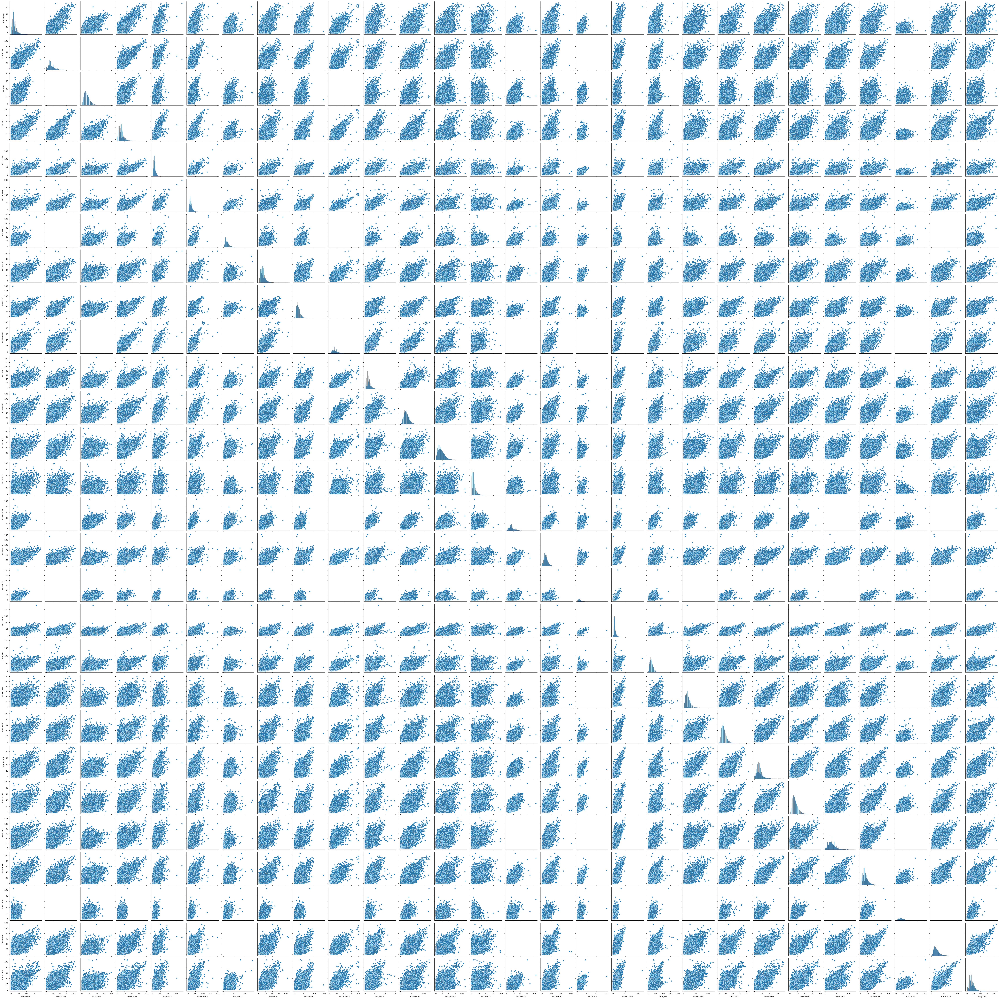

In [16]:
# Pairplot
sns.pairplot(df.select_dtypes(include=[np.number]))
plt.show()

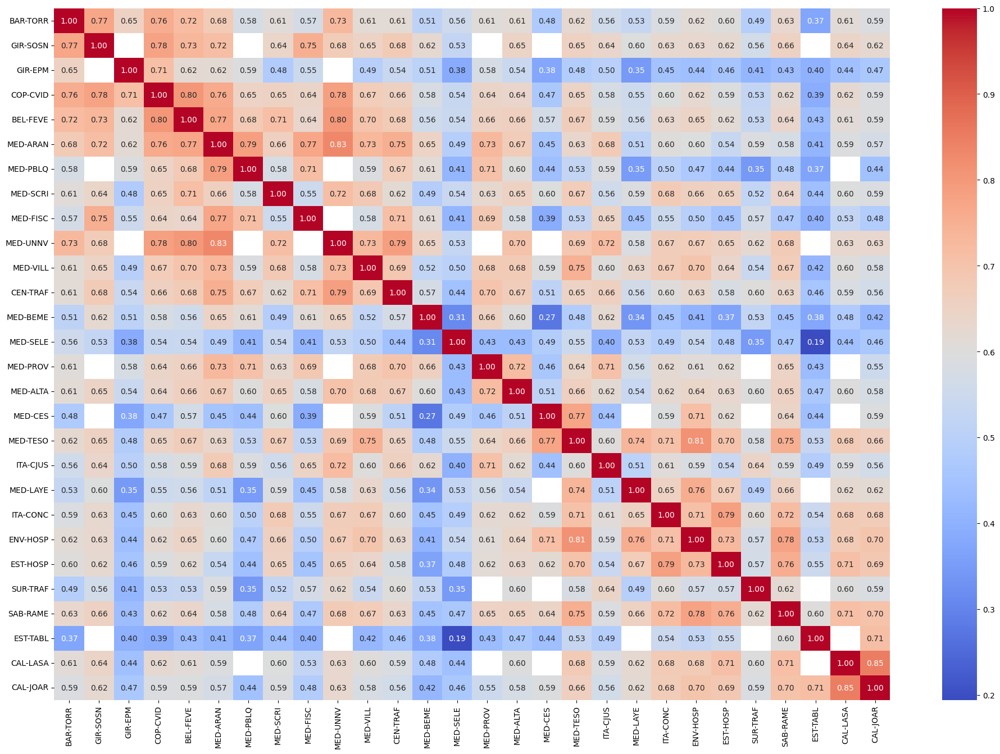

In [19]:
# Correlation matrix
corr = df.select_dtypes(include=[np.number]).corr()
plt.figure(figsize=(24, 16))
sns.heatmap(corr, annot=True, fmt=".2f", cmap='coolwarm')
plt.show()